# Self-Driving Car Engineer Nanodegree


## Project: **Finding Lane Lines on the Road** 
***
In this project, you will use the tools you learned about in the lesson to identify lane lines on the road.  You can develop your pipeline on a series of individual images, and later apply the result to a video stream (really just a series of images). Check out the video clip "raw-lines-example.mp4" (also contained in this repository) to see what the output should look like after using the helper functions below. 

Once you have a result that looks roughly like "raw-lines-example.mp4", you'll need to get creative and try to average and/or extrapolate the line segments you've detected to map out the full extent of the lane lines.  You can see an example of the result you're going for in the video "P1_example.mp4".  Ultimately, you would like to draw just one line for the left side of the lane, and one for the right.

In addition to implementing code, there is a brief writeup to complete. The writeup should be completed in a separate file, which can be either a markdown file or a pdf document. There is a [write up template](https://github.com/udacity/CarND-LaneLines-P1/blob/master/writeup_template.md) that can be used to guide the writing process. Completing both the code in the Ipython notebook and the writeup template will cover all of the [rubric points](https://review.udacity.com/#!/rubrics/322/view) for this project.

---
Let's have a look at our first image called 'test_images/solidWhiteRight.jpg'.  Run the 2 cells below (hit Shift-Enter or the "play" button above) to display the image.

**Note: If, at any point, you encounter frozen display windows or other confounding issues, you can always start again with a clean slate by going to the "Kernel" menu above and selecting "Restart & Clear Output".**

---

**The tools you have are color selection, region of interest selection, grayscaling, Gaussian smoothing, Canny Edge Detection and Hough Tranform line detection.  You  are also free to explore and try other techniques that were not presented in the lesson.  Your goal is piece together a pipeline to detect the line segments in the image, then average/extrapolate them and draw them onto the image for display (as below).  Once you have a working pipeline, try it out on the video stream below.**

---

<figure>
 <img src="examples/line-segments-example.jpg" width="380" alt="Combined Image" />
 <figcaption>
 <p></p> 
 <p style="text-align: center;"> Your output should look something like this (above) after detecting line segments using the helper functions below </p> 
 </figcaption>
</figure>
 <p></p> 
<figure>
 <img src="examples/laneLines_thirdPass.jpg" width="380" alt="Combined Image" />
 <figcaption>
 <p></p> 
 <p style="text-align: center;"> Your goal is to connect/average/extrapolate line segments to get output like this</p> 
 </figcaption>
</figure>

**Run the cell below to import some packages.  If you get an `import error` for a package you've already installed, try changing your kernel (select the Kernel menu above --> Change Kernel).  Still have problems?  Try relaunching Jupyter Notebook from the terminal prompt.  Also, consult the forums for more troubleshooting tips.**  

## Import Packages

In [1]:
# disable python warnings
import warnings
warnings.filterwarnings('ignore')

#importing some useful packages
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import cv2
%matplotlib inline

## Read in an Image

This image is: <class 'numpy.ndarray'> with dimensions: (540, 960, 3)


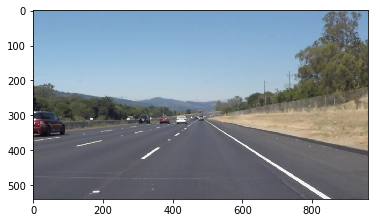

In [2]:
#reading in an image
image = mpimg.imread('test_images/solidWhiteRight.jpg')

#printing out some stats and plotting
print('This image is:', type(image), 'with dimensions:', image.shape)
plt.imshow(image)  # if you wanted to show a single color channel image called 'gray', for example, call as plt.imshow(gray, cmap='gray')

## Ideas for Lane Detection Pipeline

**Some OpenCV functions (beyond those introduced in the lesson) that might be useful for this project are:**

`cv2.inRange()` for color selection  
`cv2.fillPoly()` for regions selection  
`cv2.line()` to draw lines on an image given endpoints  
`cv2.addWeighted()` to coadd / overlay two images
`cv2.cvtColor()` to grayscale or change color
`cv2.imwrite()` to output images to file  
`cv2.bitwise_and()` to apply a mask to an image

**Check out the OpenCV documentation to learn about these and discover even more awesome functionality!**

## Helper Functions

Below are some helper functions to help get you started. They should look familiar from the lesson!

In [3]:
import math

def grayscale(img):
    """Applies the Grayscale transform
    This will return an image with only one color channel
    but NOTE: to see the returned image as grayscale
    (assuming your grayscaled image is called 'gray')
    you should call plt.imshow(gray, cmap='gray')"""
    return cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Or use BGR2GRAY if you read an image with cv2.imread()
    # return cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
def canny(img, low_threshold, high_threshold):
    """Applies the Canny transform"""
    return cv2.Canny(img, low_threshold, high_threshold)

def gaussian_blur(img, kernel_size):
    """Applies a Gaussian Noise kernel"""
    return cv2.GaussianBlur(img, (kernel_size, kernel_size), 0)

def region_of_interest(img, vertices):
    """
    Applies an image mask.
    
    Only keeps the region of the image defined by the polygon
    formed from `vertices`. The rest of the image is set to black.
    """
    #defining a blank mask to start with
    mask = np.zeros_like(img)   
    
    #defining a 3 channel or 1 channel color to fill the mask with depending on the input image
    if len(img.shape) > 2:
        channel_count = img.shape[2]  # i.e. 3 or 4 depending on your image
        ignore_mask_color = (255,) * channel_count
    else:
        ignore_mask_color = 255
        
    #filling pixels inside the polygon defined by "vertices" with the fill color    
    cv2.fillPoly(mask, vertices, ignore_mask_color)
    
    #returning the image only where mask pixels are nonzero
    masked_image = cv2.bitwise_and(img, mask)
    return masked_image


def draw_lines(img, lines, color=[255, 0, 0], thickness=2):
    """
    NOTE: this is the function you might want to use as a starting point once you want to 
    average/extrapolate the line segments you detect to map out the full
    extent of the lane (going from the result shown in raw-lines-example.mp4
    to that shown in P1_example.mp4).  
    
    Think about things like separating line segments by their 
    slope ((y2-y1)/(x2-x1)) to decide which segments are part of the left
    line vs. the right line.  Then, you can average the position of each of 
    the lines and extrapolate to the top and bottom of the lane.
    
    This function draws `lines` with `color` and `thickness`.    
    Lines are drawn on the image inplace (mutates the image).
    If you want to make the lines semi-transparent, think about combining
    this function with the weighted_img() function below
    """
    for line in lines:
        for x1,y1,x2,y2 in line:
            cv2.line(img, (x1, y1), (x2, y2), color, thickness)

def hough_lines(img, rho, theta, threshold, min_line_len, max_line_gap, image_dim=3):
    """
    `img` should be the output of a Canny transform.
        
    Returns an image with hough lines drawn.
    """
    lines = cv2.HoughLinesP(img, rho, theta, threshold, np.array([]), minLineLength=min_line_len, maxLineGap=max_line_gap)
    line_img = np.zeros((img.shape[0], img.shape[1], image_dim), dtype=np.uint8)
    if lines is not None:
        draw_lines(line_img, lines)
    return line_img

def get_hough_lines(img, rho, theta, threshold, min_line_len, max_line_gap):
    return cv2.HoughLinesP(img, rho, theta, threshold, np.array([]), minLineLength=min_line_len, maxLineGap=max_line_gap)

# Python 3 has support for cool math symbols.

def weighted_img(img, initial_img, α=0.8, β=1., λ=0.):
    """
    `img` is the output of the hough_lines(), An image with lines drawn on it.
    Should be a blank image (all black) with lines drawn on it.
    
    `initial_img` should be the image before any processing.
    
    The result image is computed as follows:
    
    initial_img * α + img * β + λ
    NOTE: initial_img and img must be the same shape!
    """
    return cv2.addWeighted(initial_img, α, img, β, λ)

## Test Images

Build your pipeline to work on the images in the directory "test_images"  
**You should make sure your pipeline works well on these images before you try the videos.**

In [4]:
import os
test_image_paths = sorted(["test_images/" + x for x in os.listdir("test_images/")])
test_image_paths

['test_images/color_picker.jpg',
 'test_images/solidWhiteCurve.jpg',
 'test_images/solidWhiteRight.jpg',
 'test_images/solidYellowCurve.jpg',
 'test_images/solidYellowCurve2.jpg',
 'test_images/solidYellowLeft.jpg',
 'test_images/whiteCarLaneSwitch.jpg',
 'test_images/zz_challenge_106.jpg',
 'test_images/zz_challenge_122.jpg',
 'test_images/zz_challenge_125.jpg',
 'test_images/zz_challenge_137.jpg']

In [5]:
# this function makes sure an output directory exists
def ensure_dir(file_path):
    if not os.path.exists(file_path):
        os.makedirs(file_path)

In [6]:
ensure_dir('test_images_output')

## Build a Lane Finding Pipeline



First, let's implement a function that applies a set of transformations and plots all the test images with transformations applied.

In [7]:
def test_pipeline_stages(stages, stages_original=None, cmap=None, cmap_original=None):
    global test_image_paths
    
    plt.figure(figsize=(20,63))
    nImages = len(test_image_paths)
    
    for i, image_path in enumerate(test_image_paths):
        image = mpimg.imread(image_path)
        original = image
        for stage in stages:
            image = stage(image)

        if stages_original:
            for stage in stages_original:
                original = stage(original)
            
        plt.subplot(nImages, 2, 2*i + 1)
        plt.imshow(original, cmap=cmap_original)
        plt.subplot(nImages, 2, 2*i + 2)
        plt.imshow(image, cmap=cmap)
    plt.show()

Now I'll use this function to test region selection.

In [8]:
INTEREST_REGION_Y_MULTIPLIER = 0.61

def polygon_region_selector(image):
        (yDim, xDim) = image.shape[:2]
        
        vertices = np.array([[
            # parameters picked by making sure the correct portion of the road is displayed in test pictures and 
            # videos
            (xDim * 0.08, yDim), 
            (xDim * 0.46, yDim * INTEREST_REGION_Y_MULTIPLIER), 
            (xDim * 0.55, yDim * INTEREST_REGION_Y_MULTIPLIER), 
            (xDim * 0.97, yDim)
        ]], dtype=np.int32)

        return region_of_interest(image, vertices)

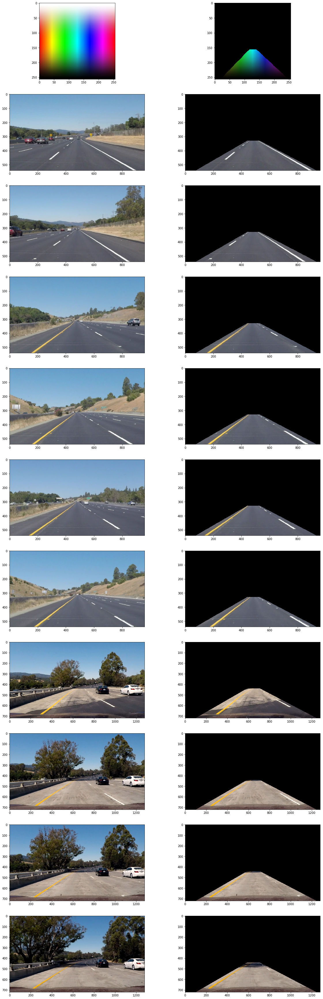

In [9]:
test_pipeline_stages([polygon_region_selector])

*There was a lot of trial and error here in order to figure out parameters for Canny and Hough transform. At first I wanted to include it, but it doesn't add much value from the point of view of the final result, so I'll keep just the final iteration here.*

In [10]:
class canny_filter:
    def __init__(self, low_threshold, high_threshold):
        self.low_threshold = low_threshold
        self.high_threshold = high_threshold
    
    def __call__(self, image):
        return canny(image, self.low_threshold, self.high_threshold)


In [11]:
class gaussian_blur_filter:
    def __init__(self, kernel_size):
        self.kernel_size = kernel_size
    
    def __call__(self, img):
        return gaussian_blur(img, self.kernel_size)


In [12]:
class hough_lines_filter:
    def __init__(self, rho, theta, threshold, min_line_len, max_line_gap, image_dim=3):
        self.rho = rho
        self.theta = theta
        self.threshold = threshold
        self.min_line_len = min_line_len
        self.max_line_gap = max_line_gap
        self.image_dim = image_dim

    def __call__(self, img):
        return hough_lines(img, self.rho, self.theta, self.threshold, self.min_line_len, self.max_line_gap, image_dim=self.image_dim)


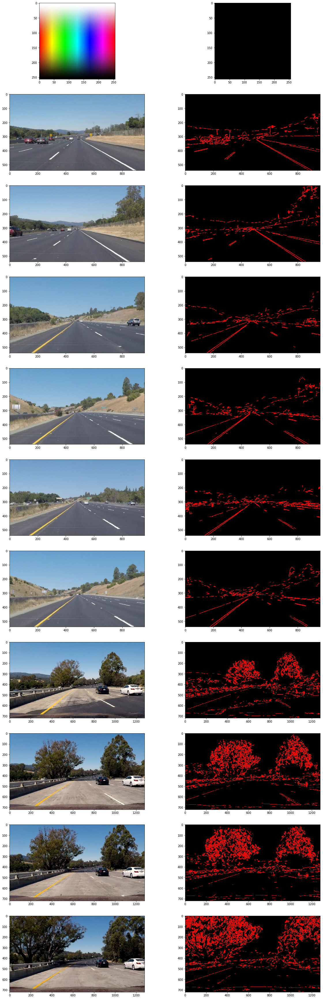

In [13]:
test_pipeline_stages([
    grayscale,
    gaussian_blur_filter(3),
    canny_filter(150/4, 150),
    hough_lines_filter(1, math.pi/180, 5, 9, 4)
], cmap="gray")

When I got to this point, I ran the current pipeline over the "challenge" video and noticed the lines disappear on some frames. So I used the following function (inserting it into the pipeline after hough_lines filter and then in the beginning of the pipeline in a separate run) to identify the frames where lines were lost.

After that, I added frames 106, 122, 125, 137 to the test images above.

In [14]:
class frame_dump_filter:
    def __init__(self):
        ensure_dir("debug")
        self.i = 0
    def __call__(self, img):
        cv2.imwrite("debug/{}.jpg".format(self.i), img[...,::-1]) # RGB -> BGR conversion
        self.i += 1
        return img

As can be seen in all of the test runs above, the yellow line is lost on all "challenge" frames. This probably happens because of the fact that asphalt is considerably brighter and more yellow there, so the gradient between the line and asphalt decreases and this prevents Canny filter from working properly. I decided to use color filter to see if I can filter out yellow and white colors. It didn't work well, so I decided to see what white and yellow lines look like in HSV color space.

In [15]:
class hsv_channel_filter:
    def __init__(self, channel):
        self.channel = channel
    def __call__(self, img):
        return cv2.cvtColor(img, cv2.COLOR_RGB2HSV)[...,self.channel]

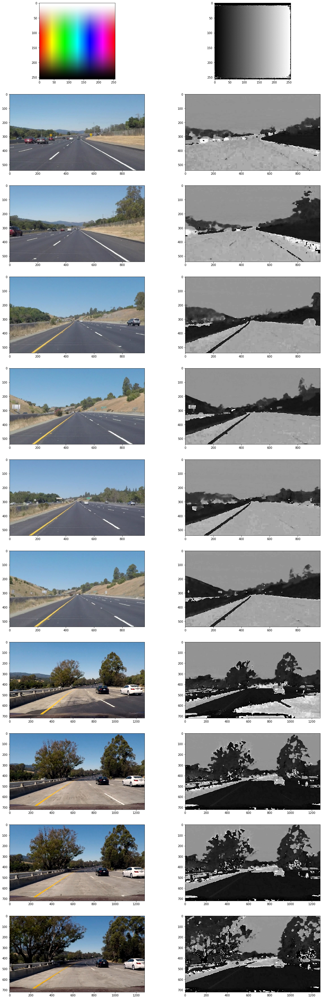

In [16]:
test_pipeline_stages([
    hsv_channel_filter(0)
], cmap="gray")

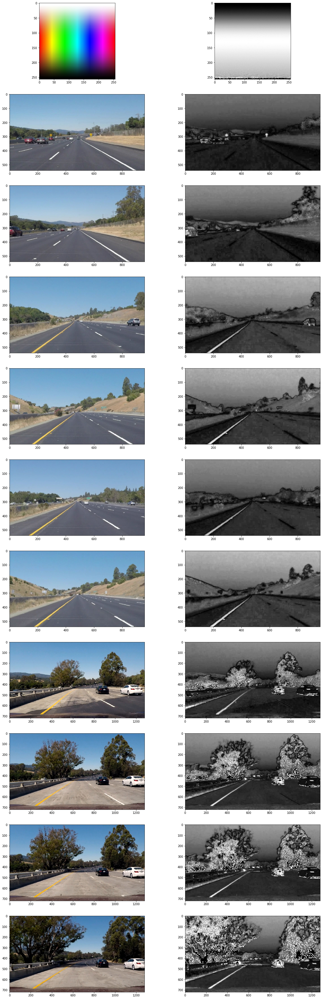

In [17]:
test_pipeline_stages([
    hsv_channel_filter(1)
], cmap="gray")

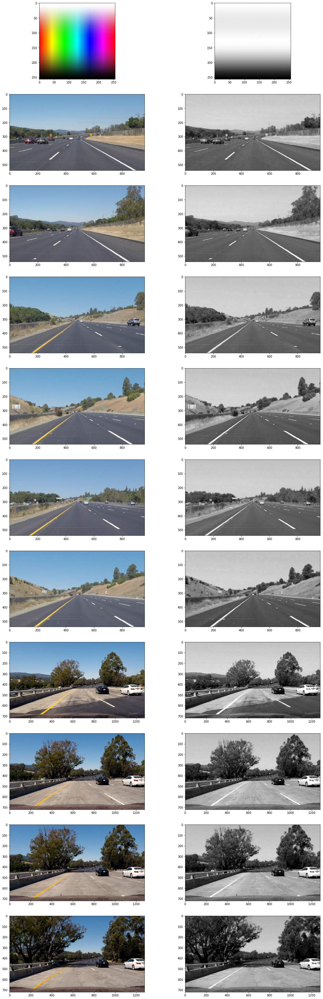

In [18]:
test_pipeline_stages([
    hsv_channel_filter(2)
], cmap="gray")

Now this gets very interesting. We can see that in HSV,
* Channel 0 (hue) allows to build a narrow band filter for yellow, but can have any values for white.
* Channel 1 (saturation) is high for yellow, low for white
* Channel 2 (value) is high for both white and yellow.

Let's build a color filter based on this. I added a color picker image to simplify tweaking the parameters here.

In [19]:
class in_range_filter:
    def __init__(self, lowerYellow, upperYellow, lowerWhite, upperWhite, dilate=False):
        self.lowerYellow = lowerYellow
        self.upperYellow = upperYellow
        self.lowerWhite = lowerWhite
        self.upperWhite = upperWhite
        self.dilate = dilate
        
    def __call__(self, img):
        hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
        mask = cv2.add(cv2.inRange(hsv, self.lowerYellow, self.upperYellow), cv2.inRange(hsv, self.lowerWhite, self.upperWhite))
        if self.dilate:
            # Dilation allows to set more strict color boundaries and then expand the mask around detected highly distinctive color points.
            # However, I actually tested dilation below and figured out it adds a lot of noise, so not using it.
            mask = cv2.dilate(mask, np.ones((4, 4),np.uint8) * 255, iterations = 1)
        return cv2.bitwise_and(img, img, mask=mask)


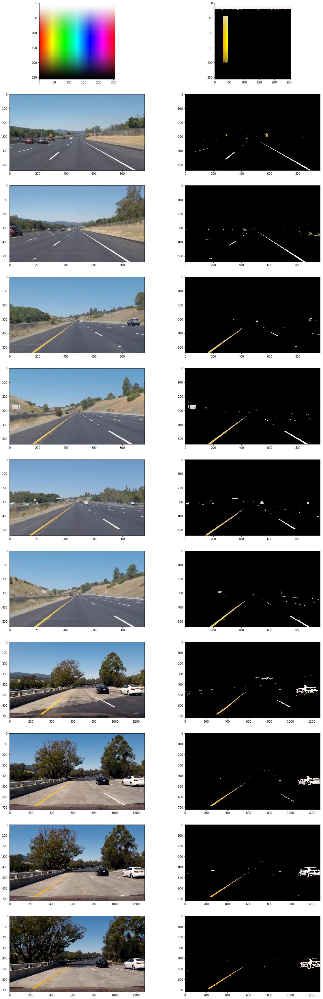

In [20]:
test_pipeline_stages([
    in_range_filter(
        (20, 80, 140), (31, 255, 255), # orange to greenish-yellow in Hue, biased towards orange 
        (0, 0, 200), (255, 20, 255),
    )
])

Looks like after this color transform we are ready to implement the entire pipeline.

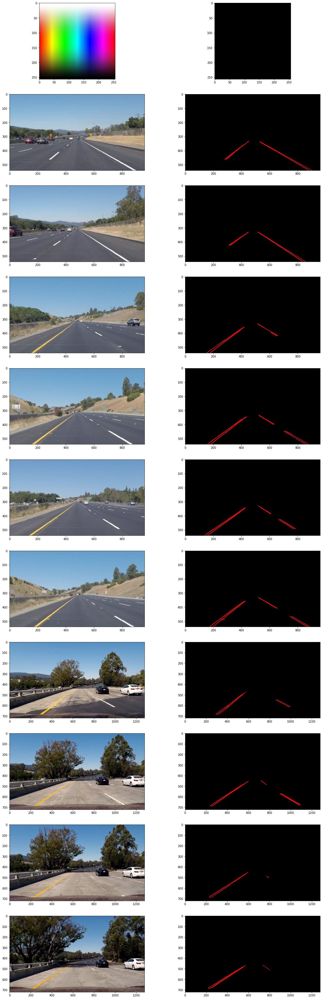

In [21]:
RHO = 1
THETA = math.pi/180/2 
THRESHOLD = 16
MIN_LINE_LEN = 20 
MAX_LINE_GAP = 50

test_pipeline_stages([
    in_range_filter(
        (20, 80, 140), (31, 255, 255),
        (0, 0, 200), (255, 20, 255),
    ),
    grayscale,
    canny_filter(120/3, 120),
    polygon_region_selector,
    hough_lines_filter(RHO, THETA, THRESHOLD, MIN_LINE_LEN, MAX_LINE_GAP),
])

In [22]:
edges_pipeline = [
    in_range_filter(
        (20, 80, 140), (31, 255, 255),
        (0, 0, 200), (255, 20, 255),
    ),
    grayscale,
    canny_filter(120/3, 120),
    polygon_region_selector
]

pipeline_stages = edges_pipeline + [
    hough_lines_filter(RHO, THETA, THRESHOLD, MIN_LINE_LEN, MAX_LINE_GAP)
]

def pipeline(image):
    global pipeline_stages
    original = image.copy()
    for stage in pipeline_stages:
        image = stage(image)
    return weighted_img(image, original)

In [23]:
for path in test_image_paths:
    image = mpimg.imread(path)
    image = pipeline(image)
    cv2.imwrite(path.replace("test_images", "test_images_output"), image[...,::-1]) # RGB -> BGR

Ok, now let's see how we can improve the drawing of lane lines. First let's look at the parameters of lines that we get:

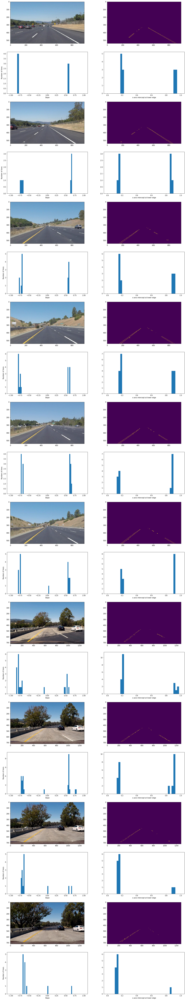

In [24]:
def plot_line_histograms():
    global test_image_paths
    global RHO, THETA, THRESHOLD, MIN_LINE_LEN, MAX_LINE_GAP
    
    plt.figure(figsize=(20,126))
    nImages = len(test_image_paths)
    
    for i, image_path in enumerate(test_image_paths[1:]):
        image = mpimg.imread(image_path)
        original = image
        for stage in edges_pipeline:
            image = stage(image)

        lines = get_hough_lines(image, RHO, THETA, THRESHOLD, MIN_LINE_LEN, MAX_LINE_GAP)
        yDim, xDim = image.shape
        slopes, intercepts = [], []
        for line in lines:
            for x1,y1,x2,y2 in line:
                # assuming y = slope*x + b, lines with positive slope should be located 
                # in the right hand side of the image
                slope = (y2-y1)/(x2-x1) 
                intercept = (yDim - y2) / slope + x2

                slopes.append(slope)
                if intercept < xDim:
                    intercepts.append(intercept / xDim)
            
        plt.subplot(nImages*2, 2, 4*i + 1)
        plt.imshow(original)
        plt.subplot(nImages*2, 2, 4*i + 2)
        plt.imshow(image)
        plt.subplot(nImages*2, 2, 4*i + 3)
        plt.hist(slopes, range=(-1, 1), bins=80, histtype='stepfilled')
        plt.xlabel("Slope")
        plt.ylabel("Number of lines")
        plt.subplot(nImages*2, 2, 4*i + 4)
        plt.hist(intercepts, range=(0, 1), bins=40, histtype='stepfilled')
        plt.xlabel("x-axis intercept at lower edge")
    plt.show()
    
plot_line_histograms()

So the histograms show that we can filter out the left hand side and the right hand side lines by thresholding on either slope < -0.5 or slope > 0.5. Probably the average slope and intercept after the thresholding will give us what we need.

## Test on Videos

You know what's cooler than drawing lanes over images? Drawing lanes over video!

We can test our solution on two provided videos:

`solidWhiteRight.mp4`

`solidYellowLeft.mp4`

**Note: if you get an import error when you run the next cell, try changing your kernel (select the Kernel menu above --> Change Kernel). Still have problems? Try relaunching Jupyter Notebook from the terminal prompt. Also, consult the forums for more troubleshooting tips.**

**If you get an error that looks like this:**
```
NeedDownloadError: Need ffmpeg exe. 
You can download it by calling: 
imageio.plugins.ffmpeg.download()
```
**Follow the instructions in the error message and check out [this forum post](https://discussions.udacity.com/t/project-error-of-test-on-videos/274082) for more troubleshooting tips across operating systems.**

In [25]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [26]:
def plot_averaged_line(img, lines):
    global INTEREST_REGION_Y_MULTIPLIER
    global RHO, THETA, THRESHOLD, MIN_LINE_LEN, MAX_LINE_GAP
    
    yDim, xDim = img.shape[:2]
    average_slope = np.average([l[0] for l in lines], weights=[l[2] for l in lines])
    average_intercept = np.average([l[1] for l in lines], weights=[l[2] for l in lines])
    
    yTarget = int(INTEREST_REGION_Y_MULTIPLIER * yDim)
    xTarget = int(average_intercept + (yTarget - yDim) / average_slope)
    cv2.line(img, (int(average_intercept), yDim), (xTarget, yTarget), [255, 0, 0], 5)

def process_image(image):
    global edges_pipeline
    original = image.copy()
    for stage in edges_pipeline:
        image = stage(image)

    lines = get_hough_lines(image, RHO, THETA, THRESHOLD, MIN_LINE_LEN, MAX_LINE_GAP)
    yDim, xDim = image.shape[:2]

    leftLines, rightLines = [], []
    for line in lines:
        for x1,y1,x2,y2 in line:
            slope = (y2-y1)/(x2-x1) 
            intercept = (yDim - y2) / slope + x2
            weight = ((x2-x1)**2 + (y2-y1)**2)

            if math.fabs(slope) > 0.5 and intercept < xDim and intercept > 0:
                if slope < 0:
                    leftLines.append((slope, intercept, weight))
                else:
                    rightLines.append((slope, intercept, weight))
   
    line_img = np.zeros((original.shape[0], original.shape[1], 3), dtype=np.uint8)
    if leftLines:
        plot_averaged_line(line_img, leftLines)
    if rightLines:
        plot_averaged_line(line_img, rightLines)
    
    result = weighted_img(line_img, original)    
    return result


Let's try the one with the solid white lane on the right first ...

In [27]:
ensure_dir('test_videos_output')
white_output = 'test_videos_output/solidWhiteRight.mp4'
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
##clip1 = VideoFileClip("test_videos/solidWhiteRight.mp4").subclip(0,5)
clip1 = VideoFileClip("test_videos/solidWhiteRight.mp4")
white_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time white_clip.write_videofile(white_output, audio=False)

[MoviePy] >>>> Building video test_videos_output/solidWhiteRight.mp4
[MoviePy] Writing video test_videos_output/solidWhiteRight.mp4


100%|█████████▉| 221/222 [00:04<00:00, 45.44it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: test_videos_output/solidWhiteRight.mp4 

CPU times: user 11.9 s, sys: 144 ms, total: 12.1 s
Wall time: 5.2 s


Play the video inline, or if you prefer find the video in your filesystem (should be in the same directory) and play it in your video player of choice.

In [28]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(white_output))

## Improve the draw_lines() function

**At this point, if you were successful with making the pipeline and tuning parameters, you probably have the Hough line segments drawn onto the road, but what about identifying the full extent of the lane and marking it clearly as in the example video (P1_example.mp4)?  Think about defining a line to run the full length of the visible lane based on the line segments you identified with the Hough Transform. As mentioned previously, try to average and/or extrapolate the line segments you've detected to map out the full extent of the lane lines. You can see an example of the result you're going for in the video "P1_example.mp4".**

**Go back and modify your draw_lines function accordingly and try re-running your pipeline. The new output should draw a single, solid line over the left lane line and a single, solid line over the right lane line. The lines should start from the bottom of the image and extend out to the top of the region of interest.**

Now for the one with the solid yellow lane on the left. This one's more tricky!

In [29]:
yellow_output = 'test_videos_output/solidYellowLeft.mp4'
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
##clip2 = VideoFileClip('test_videos/solidYellowLeft.mp4').subclip(0,5)
clip2 = VideoFileClip('test_videos/solidYellowLeft.mp4')
yellow_clip = clip2.fl_image(process_image)
%time yellow_clip.write_videofile(yellow_output, audio=False)

[MoviePy] >>>> Building video test_videos_output/solidYellowLeft.mp4
[MoviePy] Writing video test_videos_output/solidYellowLeft.mp4


100%|█████████▉| 681/682 [00:15<00:00, 47.33it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: test_videos_output/solidYellowLeft.mp4 

CPU times: user 38.9 s, sys: 340 ms, total: 39.2 s
Wall time: 16 s


In [30]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(yellow_output))

## Writeup and Submission

If you're satisfied with your video outputs, it's time to make the report writeup in a pdf or markdown file. Once you have this Ipython notebook ready along with the writeup, it's time to submit for review! Here is a [link](https://github.com/udacity/CarND-LaneLines-P1/blob/master/writeup_template.md) to the writeup template file.


## Optional Challenge

Try your lane finding pipeline on the video below.  Does it still work?  Can you figure out a way to make it more robust?  If you're up for the challenge, modify your pipeline so it works with this video and submit it along with the rest of your project!

In [31]:
challenge_output = 'test_videos_output/challenge.mp4'
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
##clip3 = VideoFileClip('test_videos/challenge.mp4').subclip(0,5)
clip3 = VideoFileClip('test_videos/challenge.mp4')
challenge_clip = clip3.fl_image(process_image)
%time challenge_clip.write_videofile(challenge_output, audio=False)

[MoviePy] >>>> Building video test_videos_output/challenge.mp4
[MoviePy] Writing video test_videos_output/challenge.mp4


100%|██████████| 251/251 [00:09<00:00, 27.16it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: test_videos_output/challenge.mp4 

CPU times: user 20.1 s, sys: 204 ms, total: 20.3 s
Wall time: 9.82 s


In [32]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(challenge_output))